In [2]:
import librosa
name = './stedman9.wav'
#name = '/Users/gfr/Google Drive/Strikeometer_NewHope/audio/GSM/gsm-ringing-10/2013_02_25_Practice-part6.wav'
cambridge, sr = librosa.load(name)


In [200]:
''' Load audio, compute spectrogram and nmf.'''
import matplotlib.pyplot as plt
from scipy import signal
import numpy as np
import librosa
import IPython
import math
from scipy import stats
from scipy import linalg
from sklearn.decomposition import NMF
from scipy.cluster.vq import whiten

def compute_nmf(clip1, sr, n, width):
  duration = len(clip1)/sr
  print(len(clip1), max(clip1))
  f, t, Sxx = signal.spectrogram(clip1, sr, mode='magnitude',
                                 nperseg=width, nfft=width, noverlap=width-width//8, scaling='density')
  print('frequency resolution is: ', f[1])
  # scale by frequency, to get power per octave, or more radical scaling??
  # When scaled by f**3, we get a dramatic percussive signal.  This requires adding another NMF
  # component, that will emphasize the percussive element.  It's inconsistent, though, so probably
  # not worth the trouble.
  # Scaling by f**2, we get very nice definition of the bell spectra.
  Sxx = np.multiply(Sxx.T, np.arange(len(f))**2).T
  Sxx = whiten(Sxx.T).T
#  fig = plt.figure(figsize=(50,5), dpi=120)
#  plt.imshow(Sxx)
#  plt.show()

  norm = linalg.norm(Sxx)
  nmf = NMF(n_components=n, max_iter=1000, tol=1e-5, alpha=1) # With white input, takes more iterations.
  trans = nmf.fit_transform(Sxx.T)
  print('nmf shape: ', nmf.components_.shape, ' iters: ', nmf.n_iter_,
        'nmf error: ', nmf.reconstruction_err_/norm)
  fig = plt.figure(figsize=(50,5), dpi=120)
  plt.plot(f, nmf.components_.T)
  plt.show()

  return t, nmf, trans


(11638464, 0.56165892)
('frequency resolution is: ', 10.7666015625)


/opt/intel/intelpython27/lib/python2.7/site-packages/scipy/cluster/vq.py:148: RuntimeWarning: Some columns have standard deviation zero. The values of these columns will not change.
  RuntimeWarning)


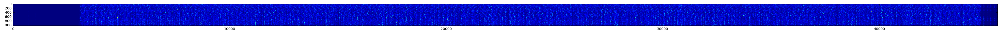

('nmf shape: ', (11, 1025), ' iters: ', 499, 'nmf error: ', 0.47972967043894665)


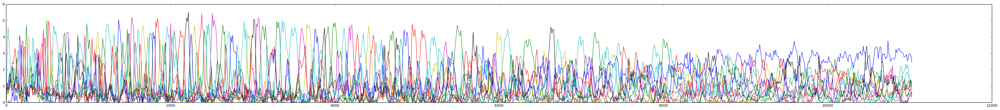

(11638464, 0.56165892)
('frequency resolution is: ', 43.06640625)


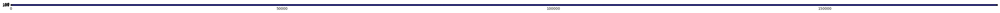

('nmf shape: ', (11, 257), ' iters: ', 499, 'nmf error: ', 0.46646916130198374)


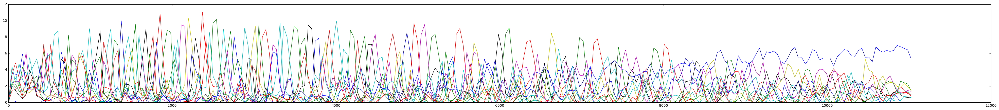

In [6]:


# TODO - collapse H by 4x and use to seed the lower resolution.
nmf2048, trans2048 = compute_nmf(cambridge, sr, 11, 2048)
nmf512, trans512 = compute_nmf(cambridge, sr, 11, 512)
#nmf256, trans256 = compute_nmf(cambridge, sr, 11, 256)

IPython.display.Audio(data=cambridge, rate=sr)


(11638464, 0.56165892)
('frequency resolution is: ', 86.1328125)
('nmf shape: ', (11, 129), ' iters: ', 999, 'nmf error: ', 0.45196894462718501)


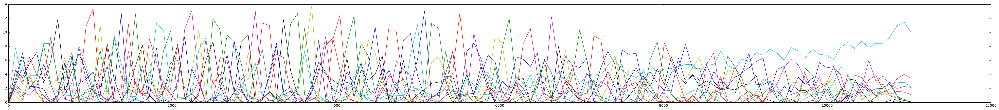

In [201]:
def compute_nmf2x(clip1, sr, n, width):
  duration = len(clip1)/sr
  print(len(clip1), max(clip1))
  f, t, Sxx = signal.spectrogram(clip1, sr, mode='magnitude',
                                 nperseg=width, nfft=2*width, noverlap=width-width//8, scaling='density')
  print('frequency resolution is: ', f[1])
  # scale by frequency, to get power per octave, or more radical scaling??
  # When scaled by f**3, we get a dramatic percussive signal.  This requires adding another NMF
  # component, that will emphasize the percussive element.  It's inconsistent, though, so probably
  # not worth the trouble.
  # Scaling by f**2, we get very nice definition of the bell spectra.
  Sxx = np.multiply(Sxx.T, np.arange(len(f))**2).T
#  Sxx = whiten(Sxx.T).T

  norm = linalg.norm(Sxx)
  nmf = NMF(n_components=n, max_iter=2000, tol=1e-5, alpha=1) # With white input, takes more iterations.
  trans = nmf.fit_transform(Sxx.T)
  print('nmf shape: ', nmf.components_.shape, ' iters: ', nmf.n_iter_,
        'nmf error: ', nmf.reconstruction_err_/norm)
  fig = plt.figure(figsize=(50,5), dpi=120)
  plt.plot(f, nmf.components_.T)
  plt.show()

  return t, nmf, trans


t256, nmf256, trans256 = compute_nmf(cambridge, sr, 11, 256)


256, matched filter > of 90th percentile
(690, ' frames per second.  Frame length (msec)', 1.44)


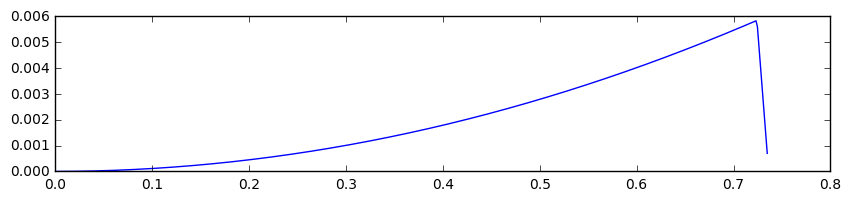

('.8 crossings: ', array([192, 197, 192, 192, 200, 202, 192, 196, 192, 192]))
('1.0 crossings: ', array([192, 197, 192, 192, 192, 192, 192, 192, 192, 192]))
('1.2 crossings: ', array([192, 189, 192, 192, 190, 176, 192, 163, 177, 160]))
('thin number edges: ', array([192, 197, 192, 192, 192, 192, 192, 191, 192, 192]))
this plot should ideally have steps very close to each other for each bell


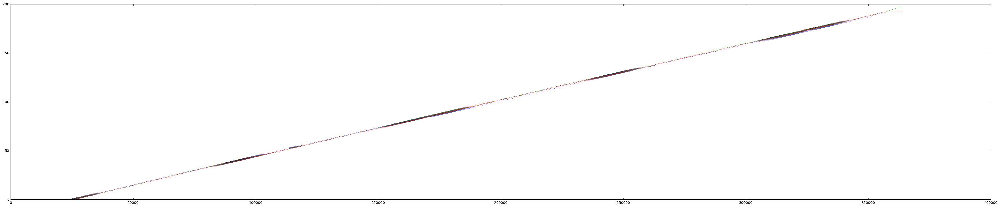

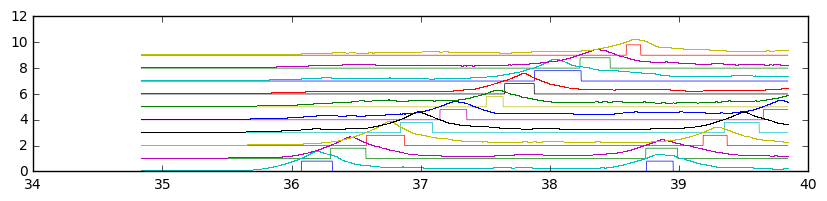

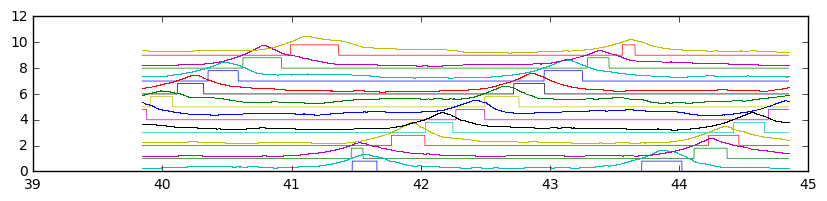

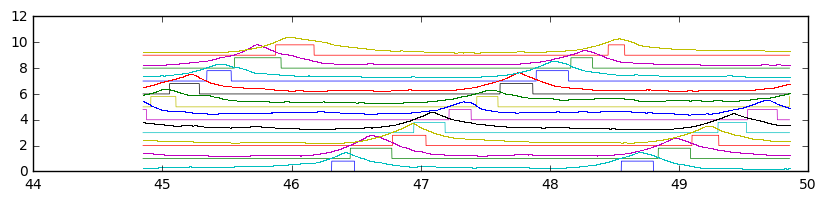

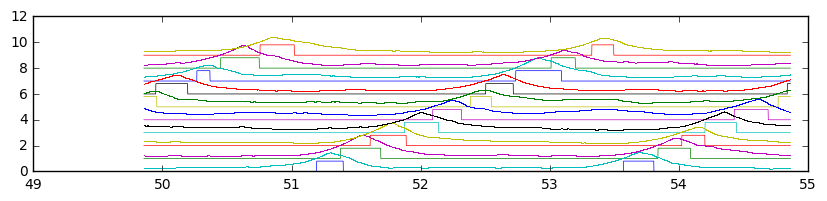

...

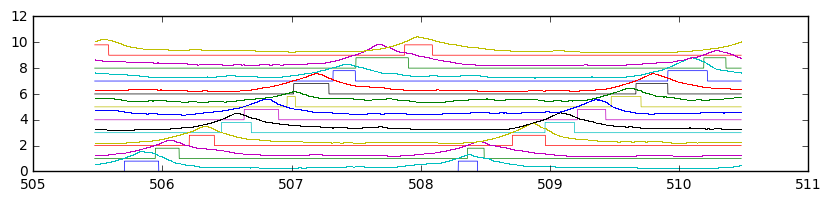

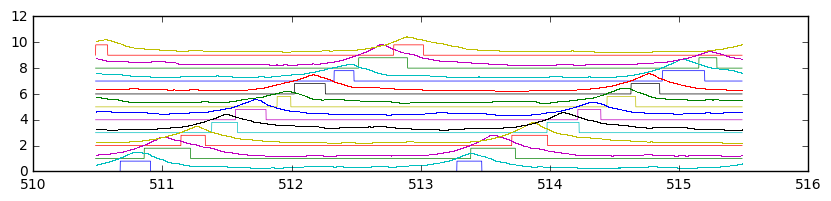

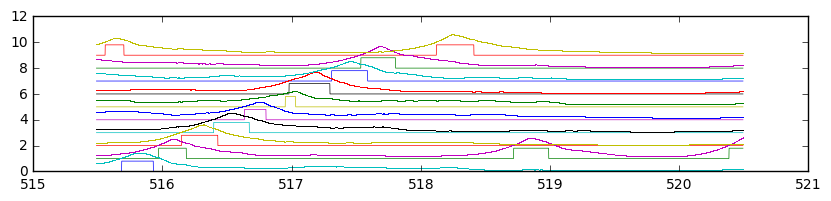

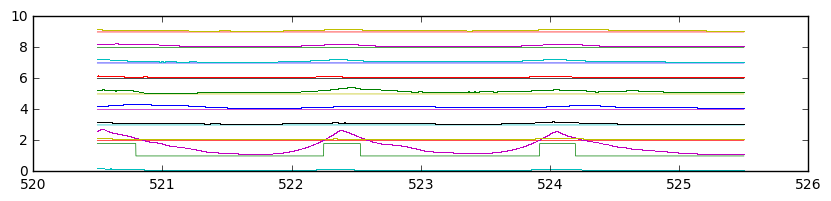

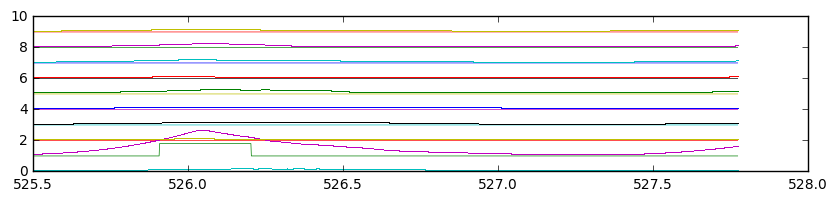

In [202]:
# matched filter?
# If the filter is properly matched, the peaks should be symmetric.
# We may want to refine the filter after initial detection.

def rising_edges(x):
    return (1-x[:-1])*x[1:]

def thin(z, n):
  t = 1*z
  x = np.ones(t.shape[1])
  for c in range(t.shape[0]):
    x = x * t[c,:] + t[c,:]
    t[c] = x

  t = t >= n
  print('thin number edges: ',( (1-t[:-1]) * t[1:] ).sum(axis=0)[order])
  print('this plot should ideally have steps very close to each other for each bell')
  fig = plt.figure(figsize=(50,10), dpi=120)
  plt.plot(rising_edges(t[:,order]).cumsum(axis=0), lw='.5')
  plt.show()

  return t[n:]

print('256, matched filter > of 90th percentile')
fps = 22100/(256/8)
print(fps, ' frames per second.  Frame length (msec)', (100000//fps)/100.0)

order = [4,1,2,5,9,10,0,8,7,6]
stagger = np.arange(len(order)).reshape(1,len(order))
# matched filter
s = np.append(np.arange(1,501)**2, [240000, 210000, 180000, 150000, 120000, 90000, 60000, 30000])
s = s/(1.0*np.sum(s))

fig = plt.figure(figsize=(10,2), dpi=120)
time = np.arange(len(s))/(1.0*fps)
plt.plot(time, s)
plt.show()

lpz = signal.convolve2d(trans256, s.reshape(len(s),1), mode='same')
# normalize on 90th percentile, such that signal is greater than 1 about 10% of the period.
z = lpz/np.percentile(lpz, q=90, axis=0)

# threshold and debounce
print('.8 crossings: ',( (z[:-1]<.8) * z[1:]>=.8 ).sum(axis=0)[order])
print('1.0 crossings: ',( (z[:-1]<1.0) * z[1:]>=1.0 ).sum(axis=0)[order])
print('1.2 crossings: ',( (z[:-1]<1.2) * z[1:]>=1.2 ).sum(axis=0)[order])

t = thin(z > 1.0,30)
for start in range(8*3000, t.shape[0],5*fps):
    end = min(start + int(5*fps), t.shape[0])
    time = np.arange(start, end)/(1.0*fps)
    fig = plt.figure(figsize=(10,2), dpi=120)
    plt.plot(t256[start:end], .8*(t[start:end,order]) + stagger, lw='.5')
    plt.plot(t256[start:end], z[start:end,order] + stagger, ',')
    plt.show()


In [2]:
import sys
print(sys.version)

2.7.12 |Intel Corporation| (default, Oct 19 2016, 16:39:13) 
[GCC 4.2.1 Compatible Apple LLVM 7.3.0 (clang-703.0.31)]
